# Prueba Técnica - Modelo No Supervistado - Clustering K_Means

## 1. Importación de Librerias

In [1]:
# Loading some basic libraries to work
import numpy as np 
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import seaborn as sns
from ydata_profiling import ProfileReport


## 1.1 Carga de datos

In [2]:
# Load the tigo dataset, given that the CSV is not using the comma as separator, I am changing the separator to the one used in the file (";").
# Also using "index_col=0", to have only one index.
tigo_df1 = pd.read_csv("prueba.csv", sep=';', delimiter=None, index_col=0)

tigo_df1.head()

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0


## 2. Analisis exploratorio de datos (EDA)


#### A través del módulo se genero un informe para un análisis previo de la información que tenemos, este mismo incluye datos estadísticos y la matriz de conexiones.

#### Tras analizar el informe, vemos que tenemos una cantidad muy pequeña de datos que no existen y datos con valores erroneos como en la EDAD y en el TRAFICO (Valores negativos en este caso). Al igual se requeire corregir valores con errores de tipeo.

#### Tras analizar la base de datos y ver nuestros objetivos, llegamos a la conclusión que las columnas de mayor interés para nuestro análisis son: "EDAD", "TRAFICO", "TIEMPO_CONEXION" y finalmente "APLICACION_ID", esta última se seleccionó dado que esta pulsado como una variable numerica.

#### Procedemos a crear un nuevo dataframe que contenga los datos que nos resulten utiles para nuestro analisis y elaboración del modelo.

In [3]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets. We can see missing cells with no duplicated rows. Also there are many rows spelled incorrectly and outliers values.
profile = ProfileReport(tigo_df1, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

# 3. Procesamiento de Datos

#### Se genero un nuevo dataframe más pequeño que contendra los datos que utilizaremos en el modelo, al igual realizaremos la tarea de limpieza de datos, manejo de valores faltantes o duplicados y transformaciones en caso de ser necesarias.

## 3.1 Limpieza de datos

## 3.1.1 Eliminación de los nulos

In [4]:
# There are 2 missing values in "EDAD", and 4 missing values in "TIEMPO_CONEXION"
tigo_df1.isnull().sum()

USUARIO                 0
EDAD                    2
APLICACION_ID           0
APLICACION              0
APLICACION_CATEGORIA    0
TRAFICO                 0
TIEMPO_CONEXION         4
dtype: int64

In [5]:
# Saving rows with nulls and then printing them
rows_with_null = tigo_df1[tigo_df1.isnull().any(axis=1)]
print(rows_with_null)


       USUARIO  EDAD  APLICACION_ID          APLICACION APLICACION_CATEGORIA   
204  347000720  47.0            748             Spotify      MUSIC STREAMING  \
271  381555740  42.0           1306              Shazam      MUSIC STREAMING   
326  388763175   NaN            927  AmazonInstantVideo      VIDEO STREAMING   
395  388981560   NaN            748             Spotify      MUSIC STREAMING   
670  381967890  25.0           1454        YouTubeMusic      MUSIC STREAMING   
741  389052015  34.0           1272              Disney      VIDEO STREAMING   

     TRAFICO  TIEMPO_CONEXION  
204  1191117              NaN  
271   461913              NaN  
326   928570            744.0  
395  8137328           1098.0  
670    12829              NaN  
741   390508              NaN  


In [6]:
# Since we have 200,000 observations, I have decided to drop them.
# After I am verifying if we have no more nulls.
tigo_df1[tigo_df1.isnull().any(axis=1)]

tigo_df1 = tigo_df1.dropna()
tigo_df1.isnull().sum()

USUARIO                 0
EDAD                    0
APLICACION_ID           0
APLICACION              0
APLICACION_CATEGORIA    0
TRAFICO                 0
TIEMPO_CONEXION         0
dtype: int64

## 3.1.2 Eliminación de los valores extremos y erroneos

In [7]:
# Cleaning Traffic
# Given this situation, I should ask if this readings of negative traffic are correct or should be considered as an error. Since this is a test I will drop this rows being attained to my own judgement.
tigo_df1.drop(tigo_df1[tigo_df1["TRAFICO"] < 0].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\951922197.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["TRAFICO"] < 0].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [8]:
# Cleaning the age of 0 years. Taking 
tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] <= 4].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\2508321995.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] <= 4].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [9]:
# Cleaning ages over 100 years.
tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] > 100].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\3861712367.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] > 100].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [10]:
unique_values = tigo_df1['APLICACION'].unique()
print(unique_values)

['Apple_Music' 'Youtube' 'iTunes' 'Spotify' 'Netflix' 'Shazam' 'Spotifyy'
 'Deezer' 'HBO' 'YouTubeMusic' 'Disney' 'AmazonInstantVideo' 'Espn'
 'AmazonMusic' 'Netflix_' 'Apple_Music_' 'FoxSports' 'HBOGO' 'Apple_TV'
 'GoogleMusic' 'TNT']


In [11]:
#Fixing names in Column of APLICATION
tigo_df1 = tigo_df1.replace("Apple_Music_", "Apple_Music")
tigo_df1 = tigo_df1.replace("Netflix_", "Netflix")
tigo_df1 = tigo_df1.replace("Spotifyy", "Spotify")


In [12]:
tigo_df1["APLICACION"].unique()

array(['Apple_Music', 'Youtube', 'iTunes', 'Spotify', 'Netflix', 'Shazam',
       'Deezer', 'HBO', 'YouTubeMusic', 'Disney', 'AmazonInstantVideo',
       'Espn', 'AmazonMusic', 'FoxSports', 'HBOGO', 'Apple_TV',
       'GoogleMusic', 'TNT'], dtype=object)

## 3.2 Visualización

In [13]:
print("Datos Estadisticos")
tigo_df1.describe()

Datos Estadisticos


,USUARIO,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION
count,1.994400e+05,199440.000000,199440.000000,1.994400e+05,1.994400e+05
mean,3.761110e+08,42.993828,605.855300,4.912790e+08,3.447969e+04
std,2.013609e+07,12.693265,378.843931,1.527595e+09,1.120402e+05
min,3.000040e+08,18.000000,256.000000,1.234000e+03,1.000000e+00
25%,3.756616e+08,33.000000,312.000000,4.073948e+05,1.070000e+02
50%,3.831779e+08,42.000000,373.000000,1.340864e+07,1.956000e+03
75%,3.884776e+08,51.000000,748.000000,2.487190e+08,2.105425e+04
max,3.999994e+08,95.000000,1455.000000,3.627219e+10,6.402138e+06


In [14]:
tigo_df1_corr = tigo_df1.copy()
tigo_df1_corr['APLICACION']=tigo_df1_corr['APLICACION'].astype('category').cat.codes
tigo_df1_corr['APLICACION_CATEGORIA']=tigo_df1_corr['APLICACION_CATEGORIA'].astype('category').cat.codes
tigo_df1_corr.corr()


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
USUARIO,1.000000,0.073448,-0.007477,0.002472,0.000408,-0.004366,-0.001282
EDAD,0.073448,1.000000,-0.044964,0.050941,0.020379,-0.048606,-0.033208
APLICACION_ID,-0.007477,-0.044964,1.000000,-0.443579,-0.405835,-0.157498,-0.173782
APLICACION,0.002472,0.050941,-0.443579,1.000000,0.009921,0.188235,0.193636
APLICACION_CATEGORIA,0.000408,0.020379,-0.405835,0.009921,1.000000,0.213992,0.210031
TRAFICO,-0.004366,-0.048606,-0.157498,0.188235,0.213992,1.000000,0.836077
TIEMPO_CONEXION,-0.001282,-0.033208,-0.173782,0.193636,0.210031,0.836077,1.000000


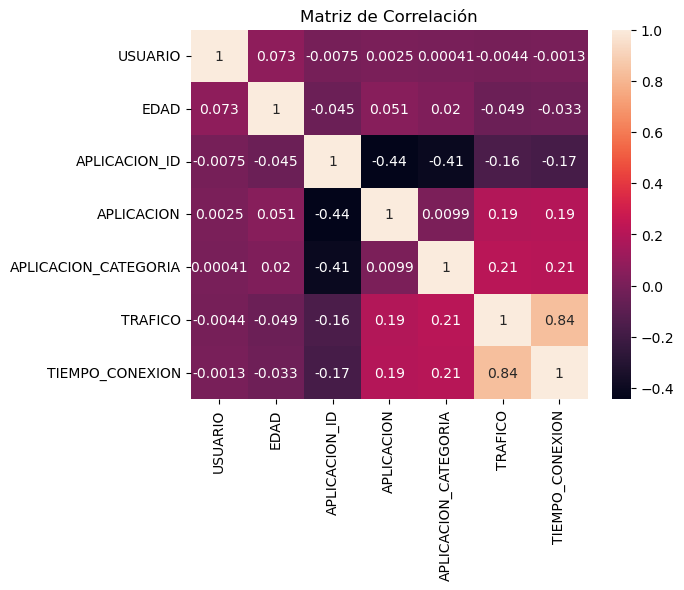

In [15]:
ax = sns.heatmap(tigo_df1_corr.corr(), annot=True).set(title='Matriz de Correlación')

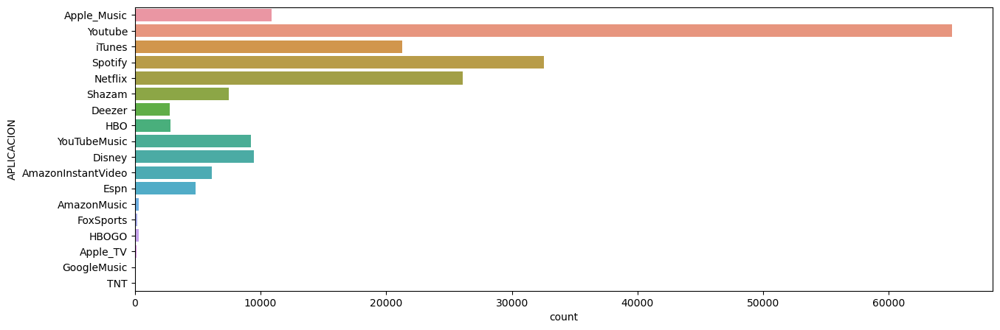

In [16]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'APLICACION' , data = tigo_df1)
plt.show()

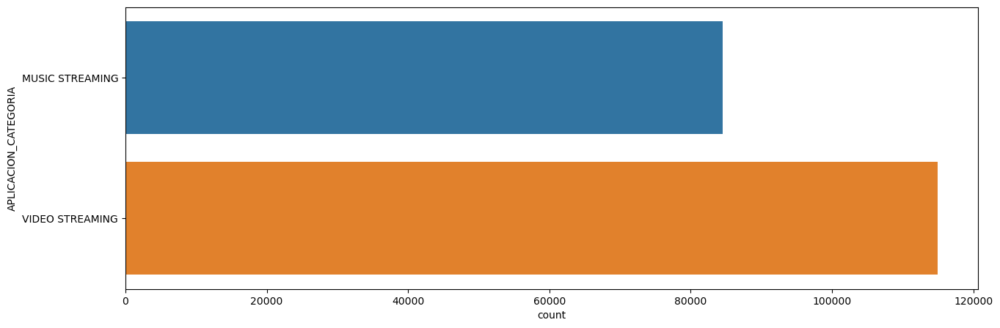

In [17]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'APLICACION_CATEGORIA' , data = tigo_df1)
plt.show()

<AxesSubplot:xlabel='EDAD', ylabel='TRAFICO'>

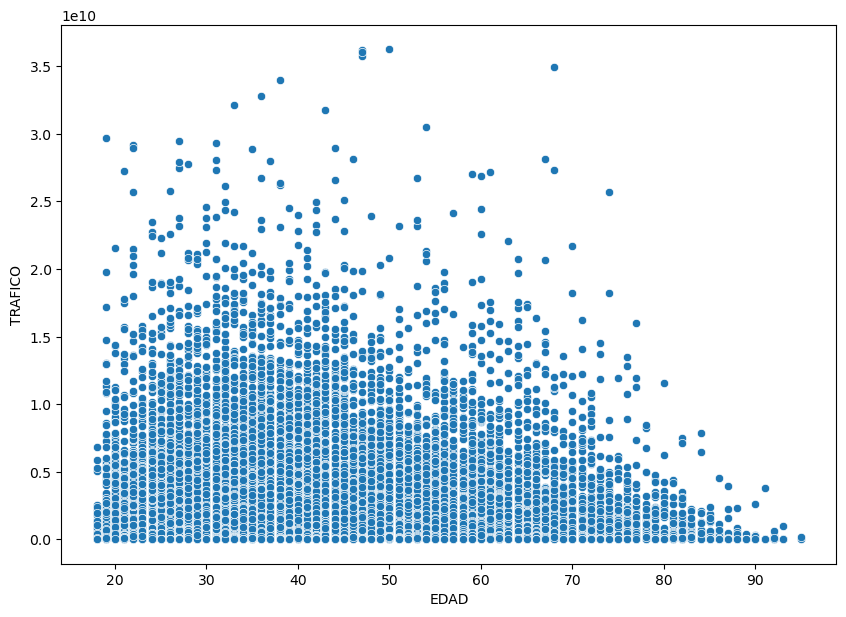

In [18]:
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_df1, x='EDAD', y='TRAFICO')

[Text(0.5, 1.0, 'BoxPlot Edad')]

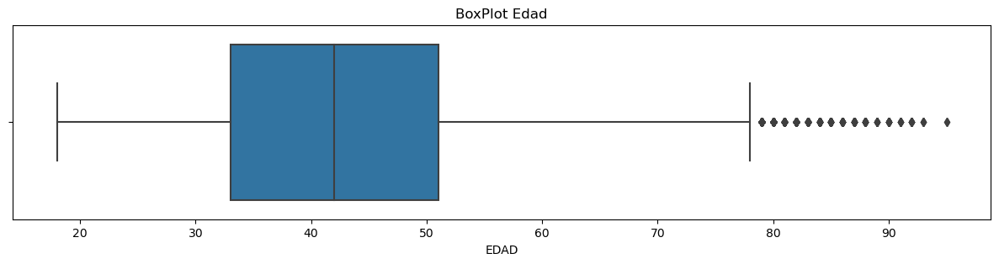

In [19]:
fig = plt.figure(figsize=(15,3))
sns.boxplot(x=tigo_df1["EDAD"] , data=tigo_df1).set(title='BoxPlot Edad')

<AxesSubplot:xlabel='TRAFICO'>

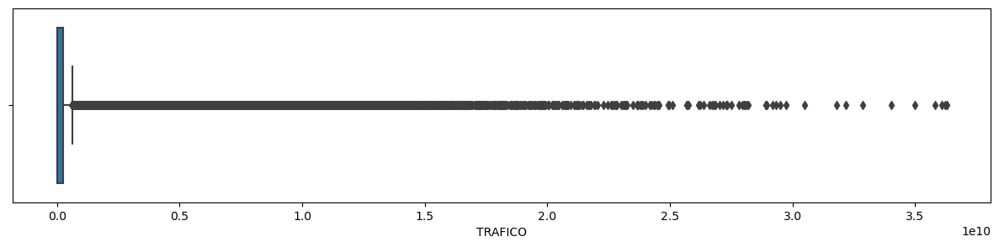

In [20]:
fig = plt.figure(figsize=(15,3))
sns.boxplot(x=tigo_df1["TRAFICO"] , data=tigo_df1)

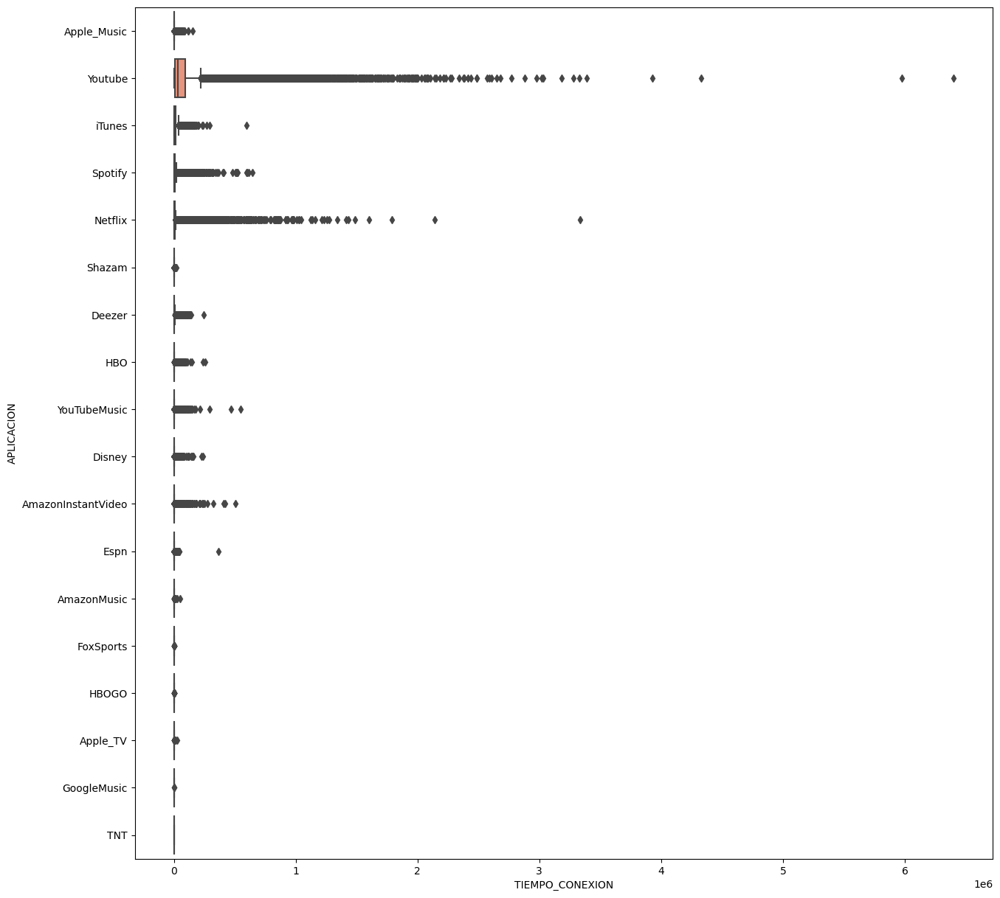

In [21]:
fig = plt.figure(figsize=(15,15))
sns.boxplot( y=tigo_df1["APLICACION"], x=tigo_df1["TIEMPO_CONEXION"] );
plt.show()

## 3.3 Selección de carateristicas

In [22]:
#Creating a Dataframe to work with K-Means, this subset will be the one that I will clean and prepare since I dont need any other columns.
x_1 = tigo_df1.copy()
x_1 = x_1.drop("USUARIO",axis=1)
x_1 = x_1.drop("APLICACION",axis=1)
x_1 = x_1.drop("APLICACION_CATEGORIA",axis=1)
x_1.head()

,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION
0,35.0,1004,64814,69.0
1,45.0,373,301331822,18778.0
2,38.0,312,2229342,547.0
3,38.0,373,16147037,2131.0
4,38.0,1004,18931,56.0


In [23]:
# Final inspection to determine if the data set is ready to work with K-Means.
profile = ProfileReport(x_1, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

# 4. Elaboración del Modelo K-Means y aplicación del mismo

#### Para llevar a cabo la tarea de segmentación del comportamiento de los clientes, recurrimos a tecnicas de agrupamiento (Clustering), este es un algoritmo del tipo "Aprendizaje no supervisado". Especificamente en este caso aplicaremos K-Means, siendo este es las común en las tareas de Clustering, cual agrupa los datos basados en similitudes.
#### El K-means se puede aplicar utilizando características relevantes como la edad, el consumo de datos y el tiempo de conexión. Estas características pueden proporcionar información sobre los diferentes patrones de uso de las aplicaciones de streaming por parte de los clientes.

#### Se debe tomar en cuenta igual la posibilidad de realizar un PCA (Analisis de las componentes principales) en conjunto con K-Means. Este mismo reduce la dimensionalidad de los datos y las transforma en conjuntos no correlacionados que pueden aplicarse el metodo de K-Means para realizar la segmentación.

#### Aclarado todo el concepto basico, se debe determinar el numero de Clusteres, para ello usaremos el metodo del codo  para encontrar la mejor cantidad de grupos que capturen la variabilidad de nuestros datos.

## 4.1 Elaboración y prueba de posibles conjuntos

In [24]:
#Created a new dataset to test Clustering without the Aplication ID
x_2 = x_1.copy()
x_2 = x_2.drop("APLICACION_ID",axis=1)
x_2.head()

,EDAD,TRAFICO,TIEMPO_CONEXION
0,35.0,64814,69.0
1,45.0,301331822,18778.0
2,38.0,2229342,547.0
3,38.0,16147037,2131.0
4,38.0,18931,56.0


In [25]:
from scipy.stats import shapiro, anderson


#Taking a Sample for testing
sample_test = x_2.sample(n=1000,replace=True)


# Shapiro-Wilk test
shapiro_test_stat, shapiro_p_value = shapiro(sample_test['EDAD'])
print("Shapiro-Wilk test:")
print("Test statistic:", shapiro_test_stat)
print("p-value:", shapiro_p_value)
# It suggests evidence against the null hypothesis of normality


# Anderson-Darling test
anderson_test_stat, anderson_critical_values, anderson_significance_levels = anderson(sample_test['EDAD'])
print("\nAnderson-Darling test:")
print("Test statistic:", anderson_test_stat)
print("Critical values:", anderson_critical_values)
print("Significance levels:", anderson_significance_levels)

Shapiro-Wilk test:
Test statistic: 0.9775674343109131
p-value: 2.6643605724463448e-11

Anderson-Darling test:
Test statistic: 4.396125405282078
Critical values: [0.574 0.653 0.784 0.914 1.088]
Significance levels: [15.  10.   5.   2.5  1. ]


Se evidencia indica que esta no es una distribucion normal. Tanto la prueba de Shapiro-Wilk como la de Anderson-Darling indican una fuerte evidencia en contra de la hipótesis nula de normalidad para su conjunto de datos. Por lo tanto, puede concluir que sus datos no siguen una distribución normal.

In [93]:
# Since we have different kinds of data in the set, its mandatory to use a scaling system. Also taking in consideration that this is NOT an Gaussian distribution, we should then use Normalization methods like MinMaxScaler. 
# Not using a scaling system or failing to use an appropiate system can lead to huge misleading in the problem(Ex: Using Standarization in this situation will cause a misleading answer).
from sklearn.preprocessing import MinMaxScaler, RobustScaler
scaler = RobustScaler()
x_1_scaled = scaler.fit_transform(x_1)
x_2_scaled = scaler.fit_transform(x_2)


In [94]:
#Analyzing the effect of scaling aplication ID
x_2_scaled


array([[-0.38888889, -0.05373824, -0.09008342],
       [ 0.16666667,  1.1595236 ,  0.80306484],
       [-0.22222222, -0.04502126, -0.0672642 ],
       ...,
       [ 0.38888889,  2.32114043,  0.76874053],
       [ 0.38888889, -0.05370177, -0.09294776],
       [ 0.38888889, -0.00927454,  0.235735  ]])

In [95]:
#Analyzing the effect of scaling aplication ID, as expected is creating noise. Descarting x_1 as a clustering dataset.
x_1_scaled

array([[-0.38888889,  1.44724771, -0.05373824, -0.09008342],
       [ 0.16666667,  0.        ,  1.1595236 ,  0.80306484],
       [-0.22222222, -0.13990826, -0.04502126, -0.0672642 ],
       ...,
       [ 0.38888889, -0.26834862,  2.32114043,  0.76874053],
       [ 0.38888889,  0.86009174, -0.05370177, -0.09294776],
       [ 0.38888889, -0.13990826, -0.00927454,  0.235735  ]])

In [96]:
#Transform into dataframe for legibility 
x_2_scaled_df = pd.DataFrame(x_2_scaled)
x_2_scaled_df


,0,1,2
0,-0.388889,-0.053738,-0.090083
1,0.166667,1.159524,0.803065
2,-0.222222,-0.045021,-0.067264
3,-0.222222,0.011028,0.008354
4,-0.222222,-0.053923,-0.090704
...,...,...,...
199435,0.055556,3.269509,2.045806
199436,0.388889,-0.051930,-0.088078
199437,0.388889,2.321140,0.768741
199438,0.388889,-0.053702,-0.092948


# 4.2 Determinación de cantidad de clusters del modelo (Hyperparameter Tuning)

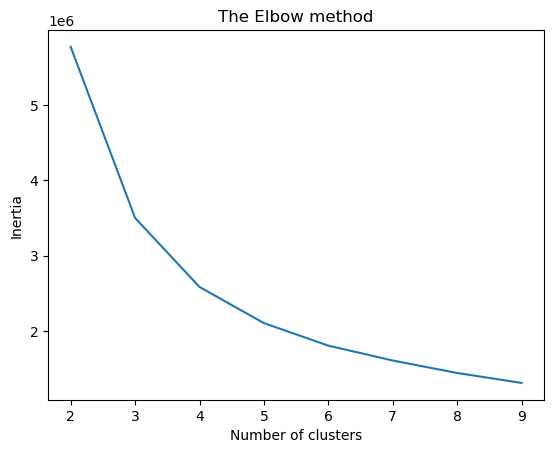

In [117]:
# Importing KMeans and determining the number of clustering through the use of the elbow method considering the Inertia.
from sklearn.cluster import KMeans

#Within cluster sum of squares (Inertia)
wcss = []


for i in range(2, 10):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', 
                    max_iter = 300, n_init = 10, random_state = 42)
    kmeans.fit(x_2_scaled)
    wcss.append(kmeans.inertia_)
    
# Plotting the results onto a line graph, 
# Allowing us to observe 'The elbow'
plt.plot(range(2, 10), wcss)
plt.title('The Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()


In [171]:
Sum_of_squared_distances = []
silhouette_scores = []
K = range(3,7) 
for _ in K:
    print(_)
    km = KMeans(n_clusters = _)
    y = km.fit_predict(df_stream_scaled)
    Sum_of_squared_distances.append(km.inertia_)
    silhouette_scores.append(silhouette_score(df_stream_scaled,y))
    

3
4
5
6


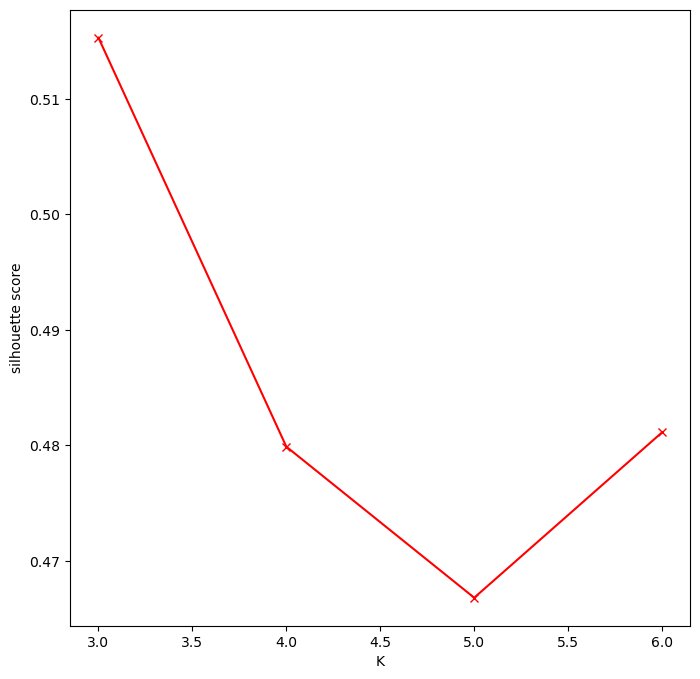

In [182]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, silhouette_scores, 'rx-')
plt.xlabel('K')
plt.ylabel('silhouette score')
plt.show()

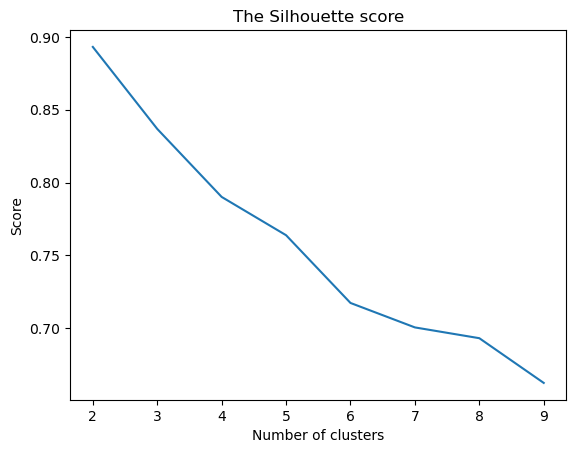

In [118]:
#Testing for Silhouette score
from sklearn.metrics import silhouette_score


sil_score = []
for i in range(2, 10):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', 
                    max_iter = 300, n_init = 10, random_state = 42)
    kmeans.fit(x_2_scaled)
    sil_test = kmeans.fit_predict(x_2_scaled_df)
    sil_score.append(silhouette_score(x_2_scaled,sil_test))
    
# Plotting the results onto a line graph, 
# Allowing us to observe 'The elbow'
plt.plot(range(2, 10), sil_score)
plt.title('The Silhouette score')
plt.xlabel('Number of clusters')
plt.ylabel('Score')
plt.show()


In [ ]:
#------------------------------------------------------THIS IS FOR PERSONAL USE --------------------------------------------------------------
# Tester for Clusters
min_clusters = 2
max_clusters = 4

best_score = -1
best_model = None
best_clusters = None


for n_clusters in range(min_clusters, max_clusters+1):
    
    model = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = model.fit_predict(x_2_scaled)
    
    
    silhouette_avg = silhouette_score(x_2_scaled, cluster_labels)
    
    
    if silhouette_avg > best_score:
        best_score = silhouette_avg
        best_model = model
        best_clusters = n_clusters

cluster_labels = best_model.labels_

# Do not forget to update this part!

tigo_df2 = tigo_df1.copy()
tigo_df2['K_Means_Label'] = cluster_labels

#Answers
print(f"El mejor número de clusters encontrado: {best_clusters}")
print(f"Índice de Silhouette: {best_score}")
print(data.head())

In [31]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, silhouette_scores, 'rx-')
plt.xlabel('K')
plt.ylabel('silhouette score')
plt.show()

NameError: name 'K' is not defined

<Figure size 800x800 with 0 Axes>

# 4.3 Entrenamiento del modelo para ambos posibles valores

In [33]:
# 3 Clusters Model
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

model = KMeans(n_clusters=3, random_state=42)
cluster_labels = model.fit_predict(x_2_scaled)
silhouette_avg_3 = silhouette_score(x_2_scaled, cluster_labels)
silhouette_avg_3

0.5075197031162106

In [34]:
# 3 Clusters Model
inertia = model.inertia_
inertia

1291.5052677352865

In [35]:
# 2 Clusters Model
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

model_2 = KMeans(n_clusters=2, random_state=42)
cluster_labels_2 = model_2.fit_predict(x_2_scaled)
silhouette_avg_2 = silhouette_score(x_2_scaled, cluster_labels_2)
silhouette_avg_2

0.5481059231616514

In [36]:
# 2 Clusters Model
inertia = model_2.inertia_
inertia

2221.319119820092

In [38]:
cluster_labels.shape

(199440,)

In [37]:
cluster_labels_2.shape

(199440,)

In [178]:
tigo_df2.shape

(199766, 8)

# 5. Hipotesis 

## 5.1 Hipotesis 1: 2 Clusters

In [119]:
tigo_2_cluster = tigo_df1.copy()
tigo_2_cluster['K_Means_Label'] = cluster_labels_2
tigo_2_cluster

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION,K_Means_Label
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0,1
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0,1
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0,1
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0,1
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0,1
...,...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0,1
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0,0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0,0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0,0


In [120]:
#Grouped Data
pd.set_option('display.max_columns', None)  

tigo_2c_grouped = tigo_2_cluster.copy()
tigo_2c_grouped = tigo_2c_grouped.drop("USUARIO",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION_CATEGORIA",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION_ID",axis=1)
tigo_2c_grouped.groupby("K_Means_Label").agg([np.mean, np.median, min, max])


EDAD                          TRAFICO                     
                    mean median   min   max          mean      median   min   
K_Means_Label                                                                 
0              56.194719   54.0  46.0  95.0  4.009106e+08  13136784.0  1234  \
1              34.858822   35.0  18.0  46.0  5.469682e+08  13562978.0  1234   

                           TIEMPO_CONEXION                          
                       max            mean  median  min        max  
K_Means_Label                                                       
0              36272186989    29709.804900  1886.0  1.0  6402138.0  
1              34029672158    37419.119663  2001.0  1.0  5977533.0

In [121]:
tigo_2_grouped = tigo_2_cluster.groupby(['K_Means_Label',"APLICACION"],sort=True)['APLICACION'].count()
tigo_2_grouped

K_Means_Label  APLICACION        
0              AmazonInstantVideo     2036
               AmazonMusic              89
               Apple_Music            4114
               Apple_TV                 33
               Deezer                  997
               Disney                 3176
               Espn                   1756
               FoxSports                46
               GoogleMusic              16
               HBO                     885
               HBOGO                    85
               Netflix                9114
               Shazam                 2585
               Spotify               12265
               TNT                       1
               YouTubeMusic           3279
               Youtube               27015
               iTunes                 8551
1              AmazonInstantVideo     4088
               AmazonMusic             219
               Apple_Music            6751
               Apple_TV                 72
               Deeze

In [122]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets.
profile = ProfileReport(tigo_2_cluster, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

### Datos Estadísticos

In [123]:
tigo_2_cluster.describe()

,USUARIO,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION,K_Means_Label
count,1.994400e+05,199440.000000,199440.000000,1.994400e+05,1.994400e+05,199440.000000
mean,3.761110e+08,42.993828,605.855300,4.912790e+08,3.447969e+04,0.618717
std,2.013609e+07,12.693265,378.843931,1.527595e+09,1.120402e+05,0.485703
min,3.000040e+08,18.000000,256.000000,1.234000e+03,1.000000e+00,0.000000
25%,3.756616e+08,33.000000,312.000000,4.073948e+05,1.070000e+02,0.000000
50%,3.831779e+08,42.000000,373.000000,1.340864e+07,1.956000e+03,1.000000
75%,3.884776e+08,51.000000,748.000000,2.487190e+08,2.105425e+04,1.000000
max,3.999994e+08,95.000000,1455.000000,3.627219e+10,6.402138e+06,1.000000


### 5.1.1 Histogramas

### Histograma de Poblaciones en Clusters

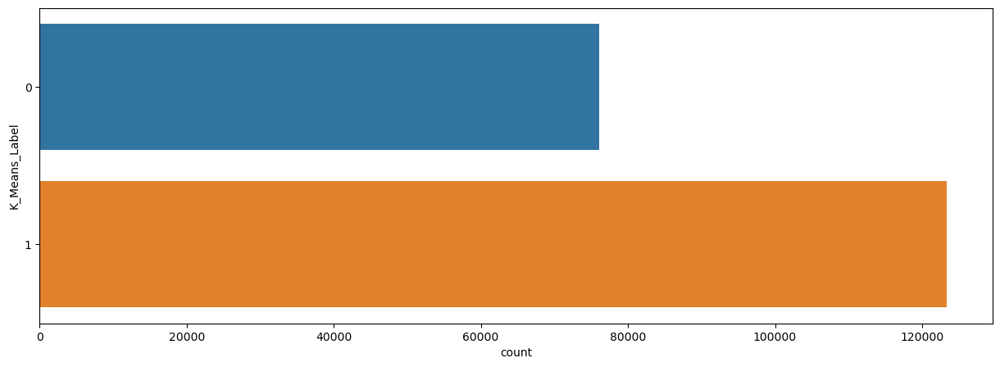

In [124]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'K_Means_Label' , data = tigo_2_cluster)
plt.show()

### Histograma - Observaciones de Aplicaciones en Clusters

<AxesSubplot:xlabel='count', ylabel='APLICACION'>

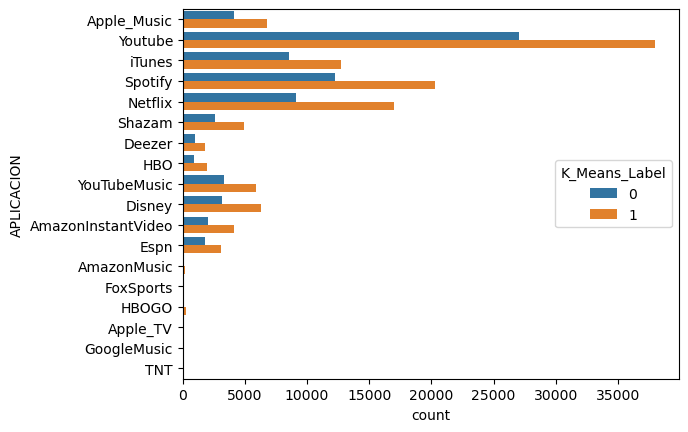

In [125]:
sns.countplot(data=tigo_2_cluster, y="APLICACION", hue="K_Means_Label")

### Diagrama de Barras - Relevancia de Cluster por aplicación

<Figure size 1000x700 with 0 Axes>

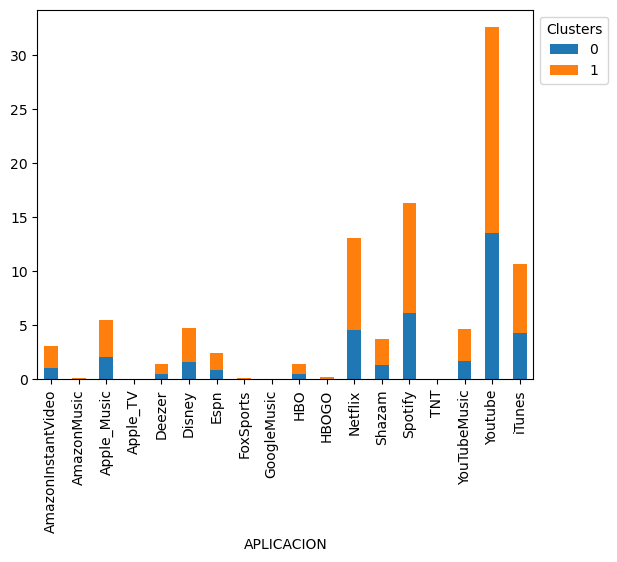

In [126]:
# App analysis
fig = plt.figure(figsize=(10,7))
#sns.countplot(data=tigo_2_cluster, x='APLICACION', hue='K_Means_Label', stacked=True)
AvK = pd.crosstab(tigo_2_cluster['APLICACION'],tigo_2_cluster['K_Means_Label'])
AvK_Percent = AvK.div(AvK.sum().sum(),axis=0)* 100

AvK_Percent.plot(kind="bar",stacked=True)
plt.legend(title='Clusters', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

<Figure size 1000x700 with 0 Axes>

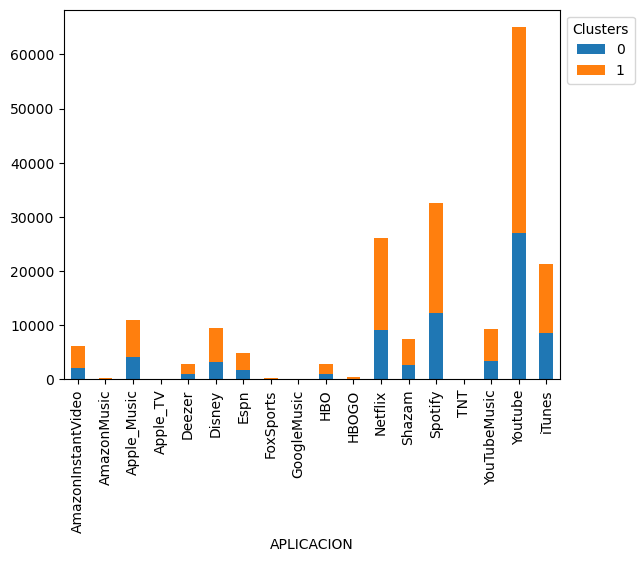

In [127]:
# App analysis
fig = plt.figure(figsize=(10,7))
#sns.countplot(data=tigo_2_cluster, x='APLICACION', hue='K_Means_Label', stacked=True)
pd.crosstab(tigo_2_cluster['APLICACION'],tigo_2_cluster['K_Means_Label']).plot(kind="bar",stacked=True)
plt.legend(title='Clusters', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()


### Diagrama de Barras - Porcentaje de presencia Categoria y Clusters

<Figure size 1000x700 with 0 Axes>

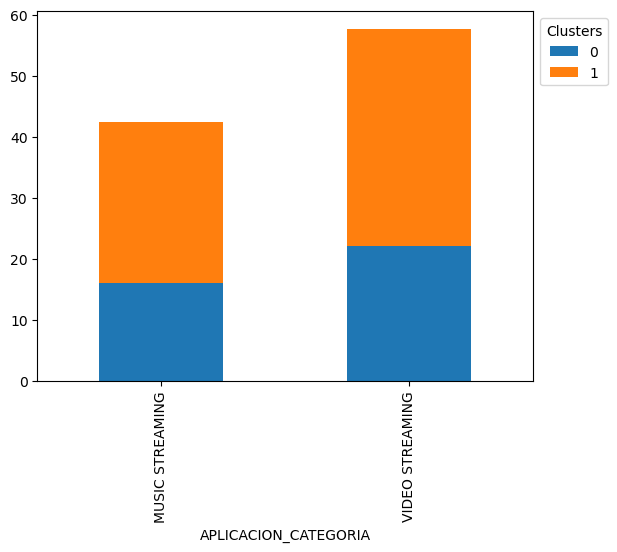

In [128]:
# App Category analysis
fig = plt.figure(figsize=(10,7))
ACvK = pd.crosstab(tigo_2_cluster['APLICACION_CATEGORIA'],tigo_2_cluster['K_Means_Label'])
ACvK_Percent = ACvK.div(ACvK.sum().sum(),axis=0)* 100

ACvK_Percent.plot(kind="bar",stacked=True)
plt.legend(title='Clusters', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

### Diagrama de Barras - Distribución del Trafico segun Aplicaciones en los Clusters.

<Figure size 2000x600 with 0 Axes>

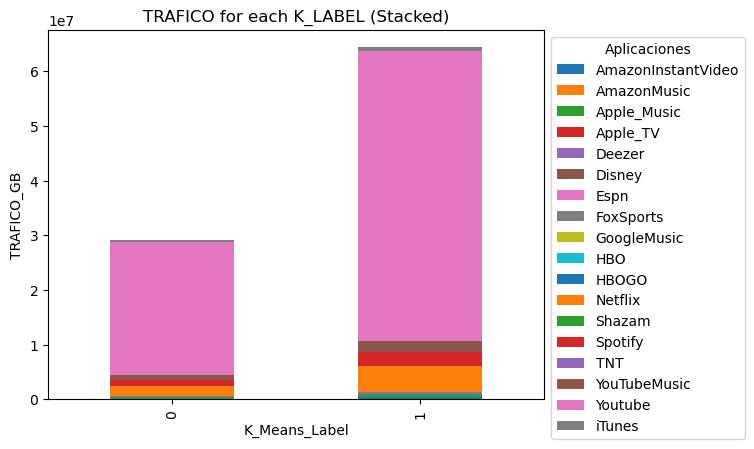

In [129]:
#Traffic Analisis
tigo_2_cluster["TRAFICO_MB"] = tigo_2_cluster["TRAFICO"]/1024
tigo_2_cluster["TRAFICO_GB"] = tigo_2_cluster["TRAFICO_MB"]/1024

grouped_data = tigo_2_cluster.groupby(['K_Means_Label', 'APLICACION'])['TRAFICO_GB'].sum().reset_index()
grouped_data['Cumulative_TRAFICO'] = grouped_data.groupby('K_Means_Label')['TRAFICO_GB'].cumsum()
stacked_data = grouped_data.pivot(index='K_Means_Label', columns='APLICACION', values='TRAFICO_GB')
plt.figure(figsize=(20, 6))
stacked_data.plot(kind='bar', stacked=True)
plt.xlabel('K_Means_Label')
plt.ylabel('TRAFICO_GB')
plt.title('TRAFICO for each K_LABEL (Stacked)')
plt.legend(title='Aplicaciones', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()


## 5.1.2 Boxplots

### Boxplot TRAFICO

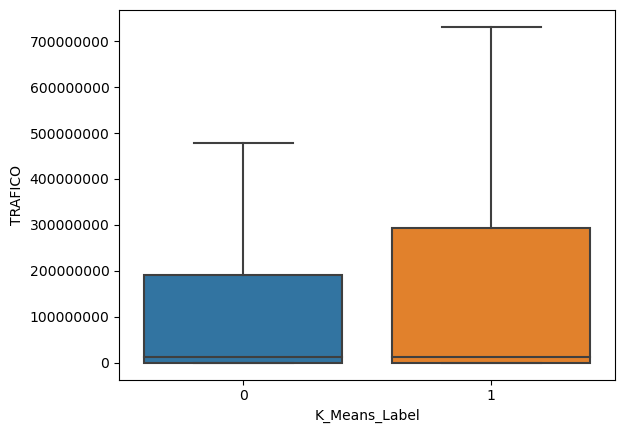

In [130]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["TRAFICO"], showfliers=False);
plt.ticklabel_format(style='plain', axis='y')
plt.show()

### Boxplot TIEMPO DE CONEXION (Segundos)

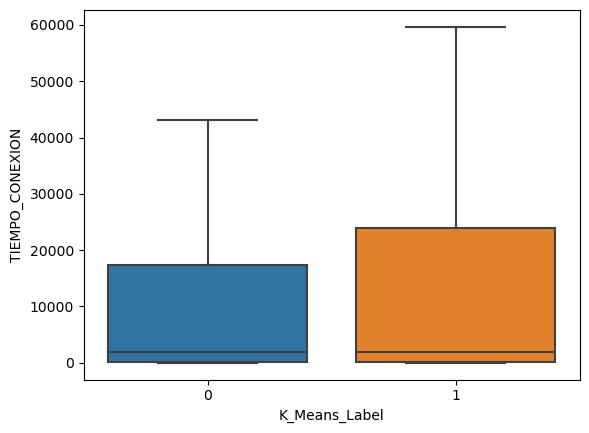

In [131]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["TIEMPO_CONEXION"], showfliers=False);
plt.show()

### Boxplot Edad

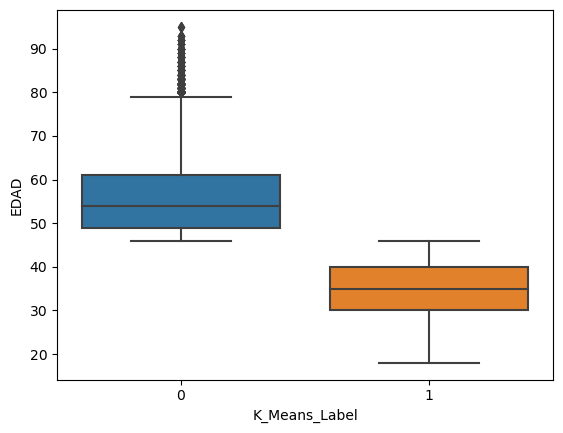

In [132]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["EDAD"] );
plt.show()

## 5.1.3 Diagramas de Dispersión

### Gráfico de dispersión - Trafico vs Edad

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\364350840.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



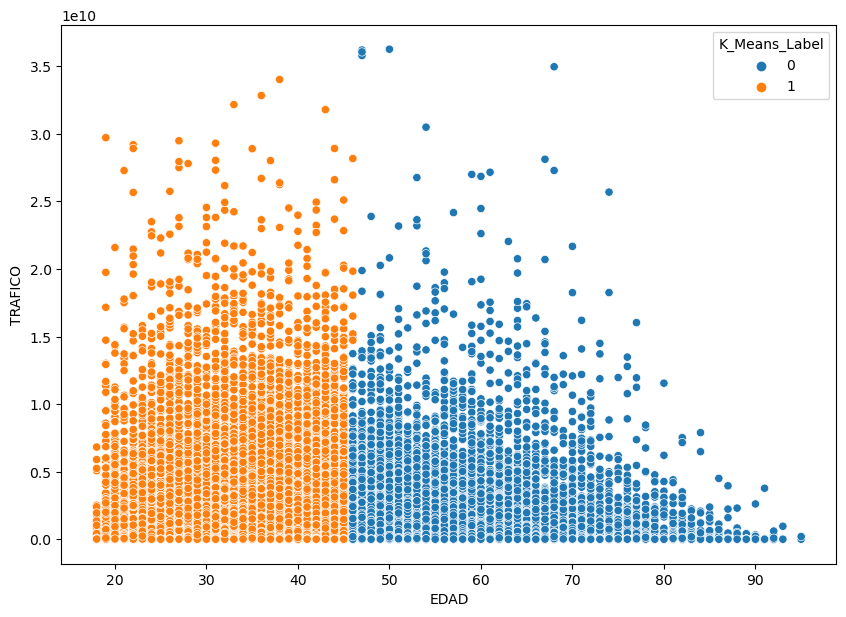

In [133]:
#Clear Segmentation  for age.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_2_cluster, x='EDAD', y='TRAFICO', hue = 'K_Means_Label')
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Edad

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\2966423732.py:8: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



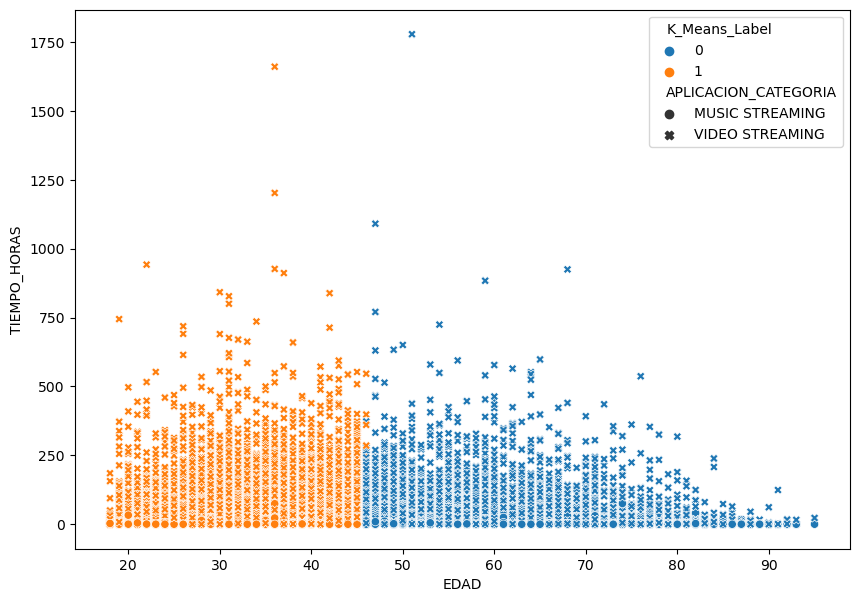

In [134]:
#Clear Segmentation  for age, fixing the conection time of seconds to hours to have a better perspective.
#Context is required to understand why there are such long connection times.
tigo_2_cluster["TIEMPO_MIN"] = tigo_2_cluster["TIEMPO_CONEXION"]/60
tigo_2_cluster["TIEMPO_HORAS"] = tigo_2_cluster["TIEMPO_CONEXION"]/3600

fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_2_cluster, x='EDAD', y='TIEMPO_HORAS', hue = 'K_Means_Label', style = "APLICACION_CATEGORIA")
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Trafico

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\2419789214.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



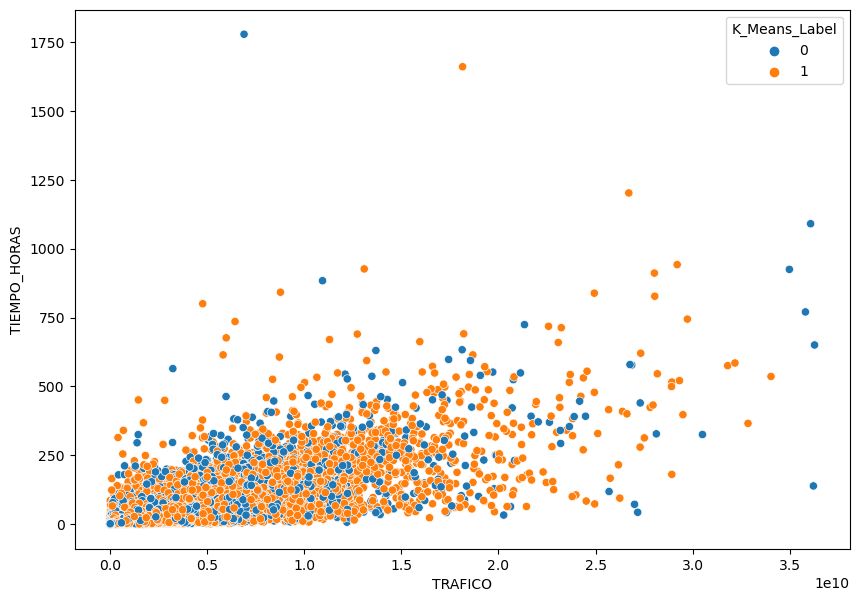

In [135]:
#Not as useful as expected, could be useful if we use color for age and shape for label.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_2_cluster, x='TRAFICO', y='TIEMPO_HORAS', hue = 'K_Means_Label')
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Trafico (Inclusión de Clusters y tipo de servicio)

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\2440528525.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



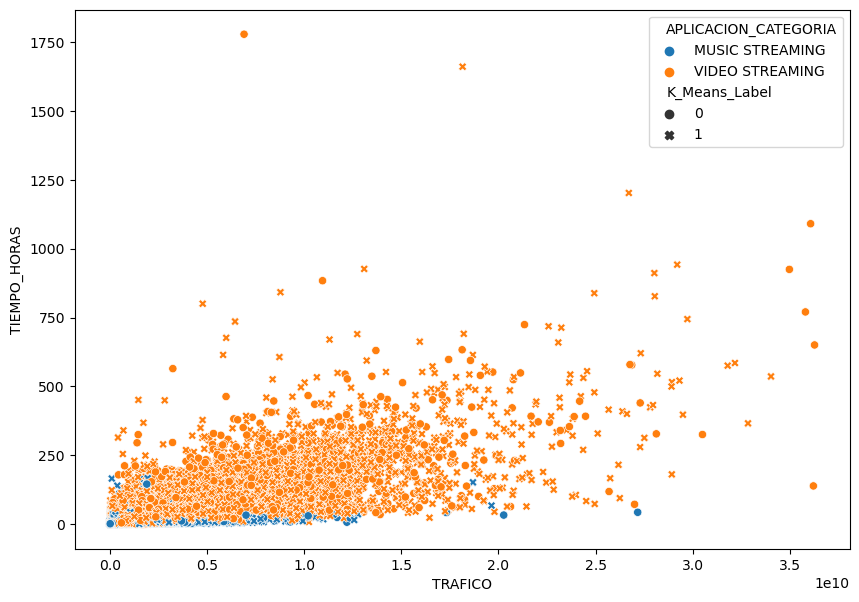

In [136]:
#Still confusing, not as useful as expected.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_2_cluster, x='TRAFICO', y='TIEMPO_HORAS', hue = 'APLICACION_CATEGORIA', style='K_Means_Label')
fig.show()

## 5.1.4 Diagrama 3D de dispersión

### Diagrama 3D de dispersión - Tiempo en horas vs Trafico en GB vs Edad

In [137]:
labels2 = model_2.labels_

import plotly.express as px

fig=px.scatter_3d(data_frame=tigo_2_cluster,x='EDAD',y='TRAFICO_GB',z='TIEMPO_HORAS',color=labels2, color_continuous_scale='bluered')
fig.update_layout(
    title={
        'text': 'Segmentación de clientes según la edad, Trafico de datos y tiempo de conexión',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

### Al igual podemos ver que el grupo mas joven es el que tiene un mayor consumo de plataformas de video, hasta un doble de conexiones, aunque estas no pueden ser consideradas como consumo.

## 5.1.4 Diagramas de violín

### Representación de la edad de la población segun el Cluster

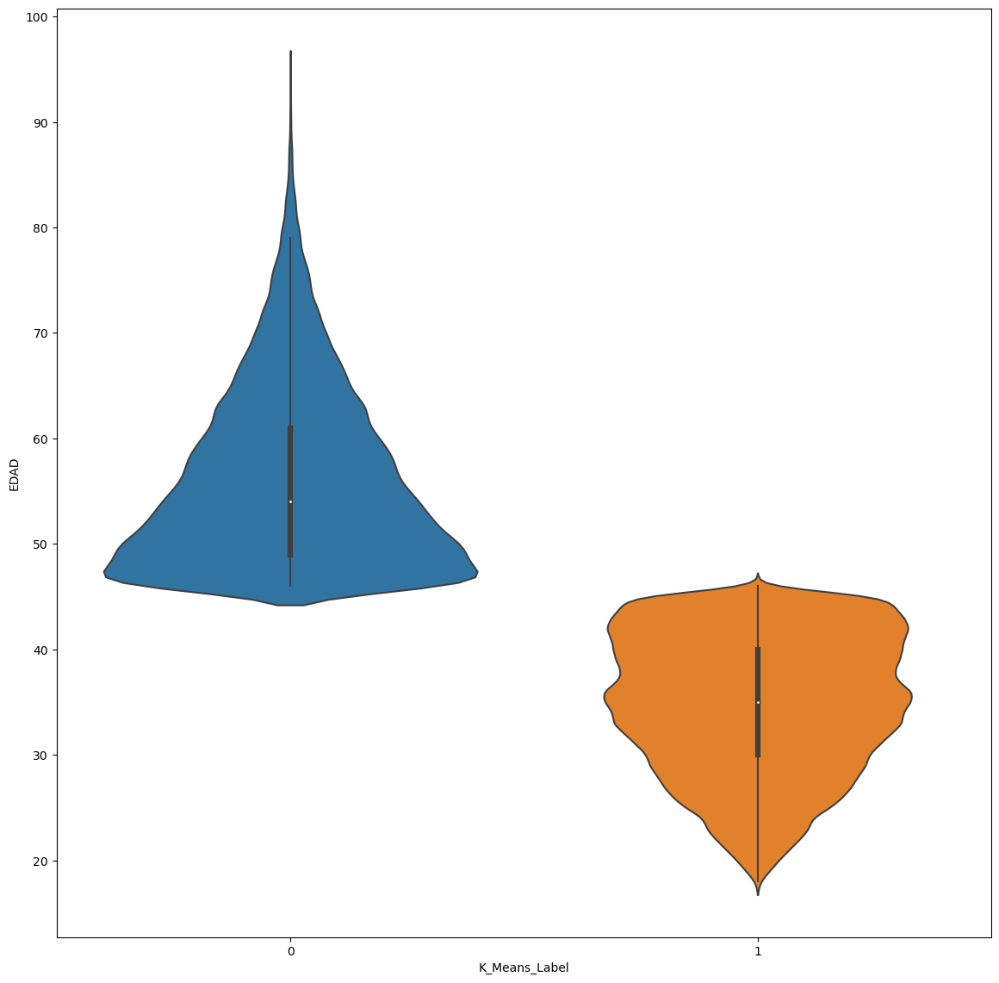

In [138]:
#Age Analysis
#Converting the diagram to percentage could help us show patterns more clearly.
plt.figure(figsize=(14, 14))
sns.violinplot(data=tigo_2_cluster, x="K_Means_Label", y="EDAD")
# Display the plot
plt.show()

# Hipotesis 2: N Clusters // Test for N Clusters

In [167]:
# N Clusters Model Test 
# change number of clusters for testing
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

model = KMeans(n_clusters=3, random_state=42)

cluster_labels_n = model.fit_predict(x_2_scaled)
silhouette_avg_n = silhouette_score(x_2_scaled, cluster_labels_n)

print("Inertia score for this model is", silhouette_avg_n)

Inertia score for this model is 0.8368289954998928


In [168]:
# N Clusters Model Inertia
inertia = model.inertia_
inertia

3501599.364090266

In [169]:
tigo_n_cluster = tigo_df1.copy()
tigo_n_cluster['K_Means_Label'] = cluster_labels_n
tigo_n_cluster

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION,K_Means_Label
0,347095500,35.00,1004,Apple_Music,MUSIC STREAMING,64814,69.00,0
1,347102885,45.00,373,Youtube,VIDEO STREAMING,301331822,18778.00,0
2,347103445,38.00,312,iTunes,MUSIC STREAMING,2229342,547.00,0
3,347103445,38.00,373,Youtube,VIDEO STREAMING,16147037,2131.00,0
4,347103445,38.00,1004,Apple_Music,MUSIC STREAMING,18931,56.00,0
...,...,...,...,...,...,...,...,...
199995,385616605,43.00,373,Youtube,VIDEO STREAMING,825265705,44810.00,0
199996,385628825,49.00,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.00,0
199997,385628825,49.00,256,Netflix,VIDEO STREAMING,589774771,18059.00,0
199998,385628825,49.00,748,Spotify,MUSIC STREAMING,73871,9.00,0


In [170]:
#Grouped Data
pd.set_option('display.max_columns', None)  

tigo_nc_grouped = tigo_n_cluster.copy()
tigo_nc_grouped = tigo_nc_grouped.drop("USUARIO",axis=1)
tigo_nc_grouped = tigo_nc_grouped.drop("APLICACION",axis=1)
tigo_nc_grouped = tigo_nc_grouped.drop("APLICACION_CATEGORIA",axis=1)
tigo_nc_grouped = tigo_nc_grouped.drop("APLICACION_ID",axis=1)
tigo_nc_grouped.groupby("K_Means_Label").agg([np.mean, np.median, min, max])


EDAD                           TRAFICO                  
               mean median   min   max           mean         median   
K_Means_Label                                                          
0             43.15  42.00 18.00 95.00   179031705.75     7637327.50  \
1             40.97  39.00 18.00 91.00  3652700870.54  3182547842.50   
2             40.79  39.00 19.00 84.00 11950118089.79 10933134430.50   

                                      TIEMPO_CONEXION                      
                     min          max            mean    median      min   
K_Means_Label                                                              
0                   1234   2996868596        13560.74   1311.00     1.00  \
1               89149709  12572391048       237936.58 207860.00  6148.00   
2              689859248  36272186989       862282.11 773620.50 84813.00   

                          
                     max  
K_Means_Label             
0              311941.00  
1             1132681.00  
2             6402138.00

In [171]:
tigo_n_grouped = tigo_n_cluster.groupby(['K_Means_Label',"APLICACION"],sort=True)['APLICACION'].count()
tigo_n_grouped

K_Means_Label  APLICACION        
0              AmazonInstantVideo     6063
               AmazonMusic             308
               Apple_Music           10793
               Apple_TV                105
               Deezer                 2764
               Disney                 9475
               Espn                   4800
               FoxSports               167
               GoogleMusic              38
               HBO                    2817
               HBOGO                   319
               Netflix               25232
               Shazam                 7479
               Spotify               32296
               TNT                       1
               YouTubeMusic           8962
               Youtube               52677
               iTunes                21258
1              AmazonInstantVideo       59
               Apple_Music              71
               Deezer                   31
               Espn                      1
               Netfl

In [172]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets.
profile = ProfileReport(tigo_n_cluster, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

### Datos Estadísticos

In [173]:
tigo_n_cluster.describe()

,USUARIO,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION,K_Means_Label
count,199440.00,199440.00,199440.00,199440.00,199440.00,199440.00
mean,376111001.49,42.99,605.86,491278997.96,34479.69,0.08
std,20136088.30,12.69,378.84,1527594539.79,112040.16,0.30
min,300004040.00,18.00,256.00,1234.00,1.00,0.00
25%,375661620.00,33.00,312.00,407394.75,107.00,0.00
50%,383177900.00,42.00,373.00,13408644.00,1956.00,0.00
75%,388477630.00,51.00,748.00,248719009.25,21054.25,0.00
max,399999385.00,95.00,1455.00,36272186989.00,6402138.00,2.00


### 5.1.1 Histogramas

### Histograma de Poblaciones en Clusters

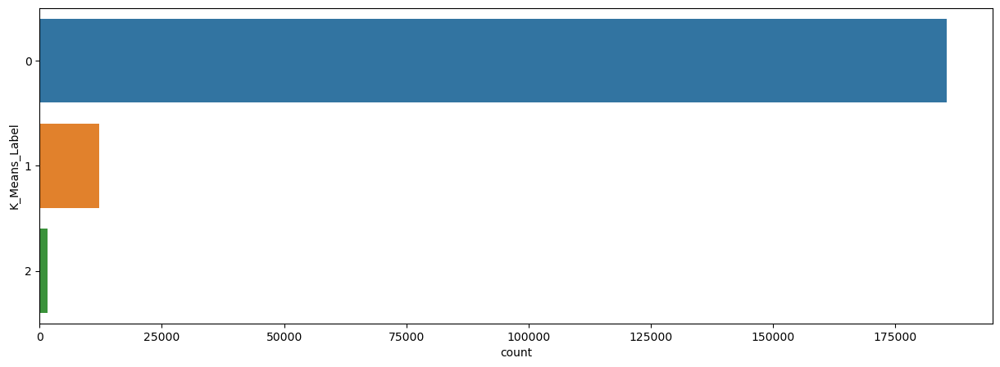

In [174]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'K_Means_Label' , data = tigo_n_cluster)
plt.show()

### Histograma - Observaciones de Aplicaciones en Clusters

<AxesSubplot:xlabel='count', ylabel='APLICACION'>

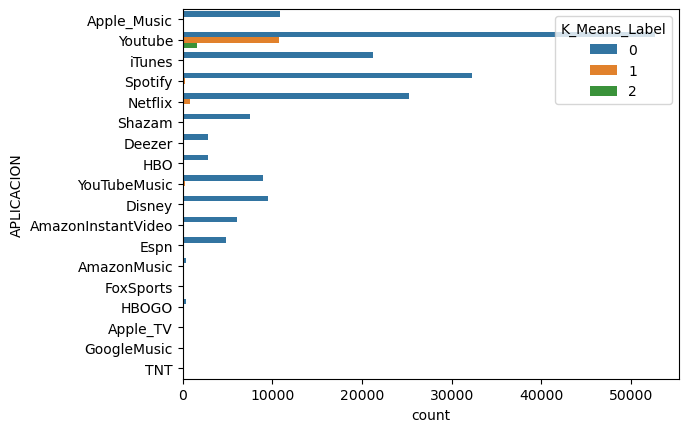

In [175]:
sns.countplot(data=tigo_n_cluster, y="APLICACION", hue="K_Means_Label")

### Diagrama de Barras - Relevancia de Cluster por aplicación

<Figure size 1000x700 with 0 Axes>

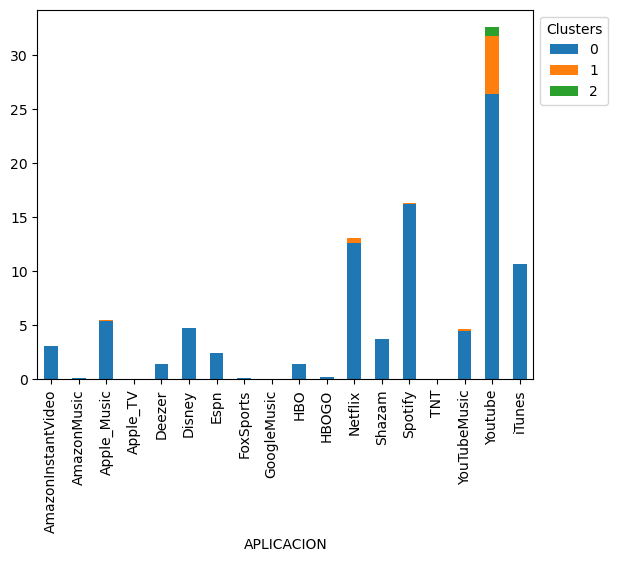

In [176]:
# App analysis
fig = plt.figure(figsize=(10,7))
#sns.countplot(data=tigo_2_cluster, x='APLICACION', hue='K_Means_Label', stacked=True)
N_AvK = pd.crosstab(tigo_n_cluster['APLICACION'],tigo_n_cluster['K_Means_Label'])
N_AvK_Percent = N_AvK.div(N_AvK.sum().sum(),axis=0)* 100

N_AvK_Percent.plot(kind="bar",stacked=True)
plt.legend(title='Clusters', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

### Diagrama de Barras - Porcentaje de presencia Categoria y Clusters

<Figure size 1000x700 with 0 Axes>

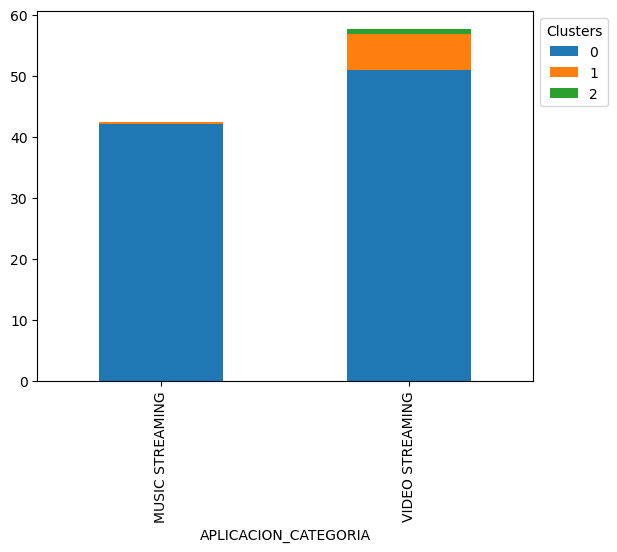

In [177]:
# App Category analysis
fig = plt.figure(figsize=(10,7))
N_ACvK = pd.crosstab(tigo_n_cluster['APLICACION_CATEGORIA'],tigo_n_cluster['K_Means_Label'])
N_ACvK_Percent = N_ACvK.div(N_ACvK.sum().sum(),axis=0)* 100

N_ACvK_Percent.plot(kind="bar",stacked=True)
plt.legend(title='Clusters', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

### Diagrama de Barras - Distribución del Trafico segun Aplicaciones en los Clusters.

<Figure size 2000x600 with 0 Axes>

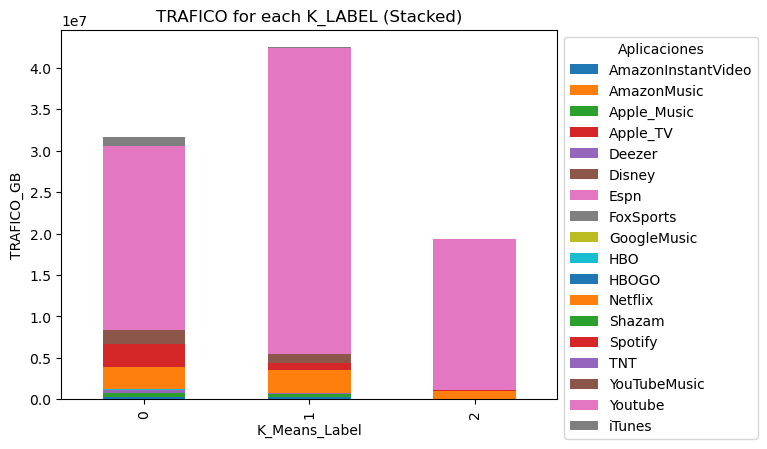

In [178]:
#Traffic Analisis
tigo_n_cluster["TRAFICO_MB"] = tigo_n_cluster["TRAFICO"]/1024
tigo_n_cluster["TRAFICO_GB"] = tigo_n_cluster["TRAFICO_MB"]/1024

n_grouped_data = tigo_n_cluster.groupby(['K_Means_Label', 'APLICACION'])['TRAFICO_GB'].sum().reset_index()
n_grouped_data['Cumulative_TRAFICO'] = n_grouped_data.groupby('K_Means_Label')['TRAFICO_GB'].cumsum()
n_stacked_data = n_grouped_data.pivot(index='K_Means_Label', columns='APLICACION', values='TRAFICO_GB')
plt.figure(figsize=(20, 6))
n_stacked_data.plot(kind='bar', stacked=True)
plt.xlabel('K_Means_Label')
plt.ylabel('TRAFICO_GB')
plt.title('TRAFICO for each K_LABEL (Stacked)')
plt.legend(title='Aplicaciones', bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

## 5.1.2 Boxplots

### Boxplot TRAFICO

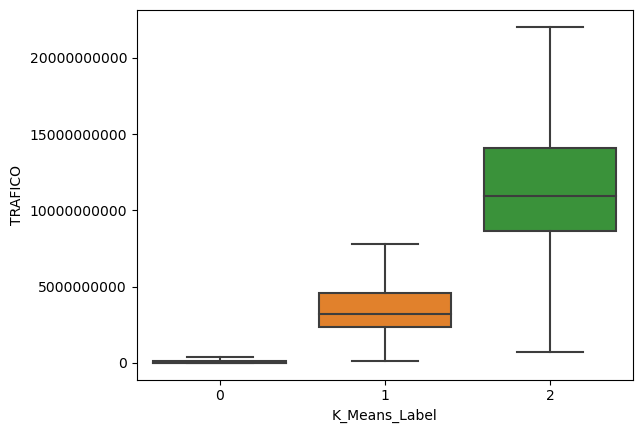

In [179]:
sns.boxplot( x=tigo_n_cluster["K_Means_Label"], y=tigo_n_cluster["TRAFICO"], showfliers=False);
plt.ticklabel_format(style='plain', axis='y')
plt.show()

### Boxplot TIEMPO DE CONEXION (Segundos)

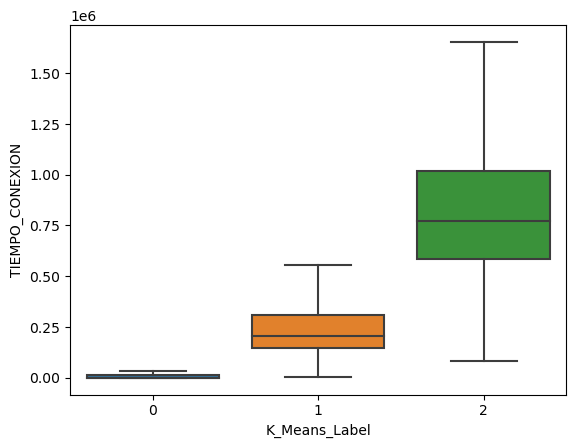

In [180]:
sns.boxplot( x=tigo_n_cluster["K_Means_Label"], y=tigo_n_cluster["TIEMPO_CONEXION"], showfliers=False);
plt.show()

### Boxplot Edad

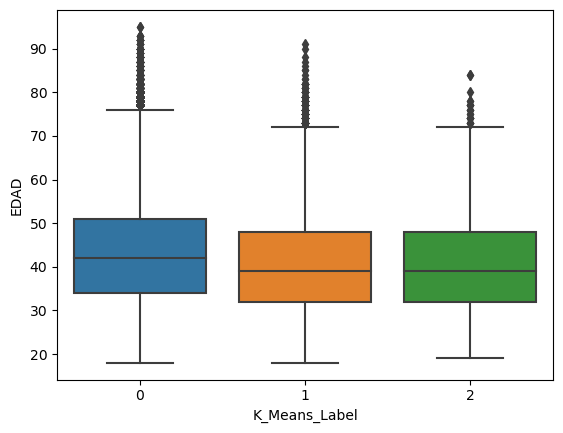

In [181]:
sns.boxplot( x=tigo_n_cluster["K_Means_Label"], y=tigo_n_cluster["EDAD"] );
plt.show()

## 5.1.3 Diagramas de Dispersión

### Gráfico de dispersión - Trafico vs Edad

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\1334704032.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



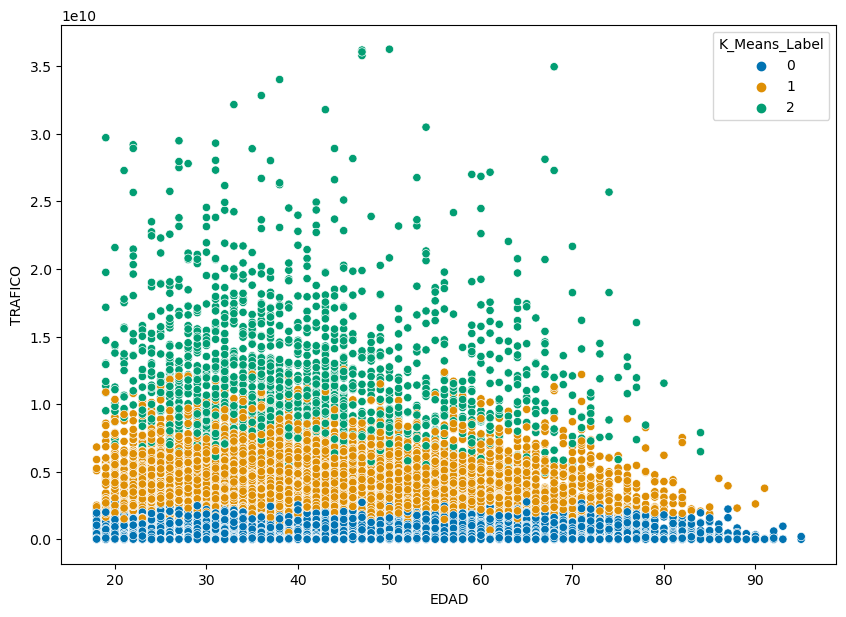

In [182]:
#Clear Segmentation  for age.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_n_cluster, x='EDAD', y='TRAFICO', hue = 'K_Means_Label', palette="colorblind")
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Edad

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\1134241411.py:8: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



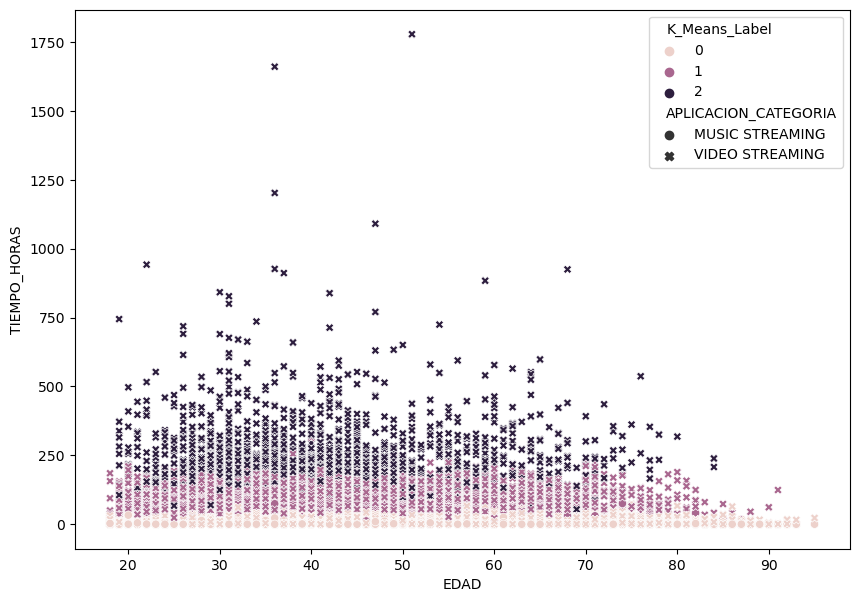

In [183]:
#Clear Segmentation  for age, fixing the conection time of seconds to hours to have a better perspective.
#Context is required to understand why there are such long connection times.
tigo_n_cluster["TIEMPO_MIN"] = tigo_n_cluster["TIEMPO_CONEXION"]/60
tigo_n_cluster["TIEMPO_HORAS"] = tigo_n_cluster["TIEMPO_CONEXION"]/3600

fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_n_cluster, x='EDAD', y='TIEMPO_HORAS', hue = 'K_Means_Label', style = "APLICACION_CATEGORIA")
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Trafico

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\1654259834.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



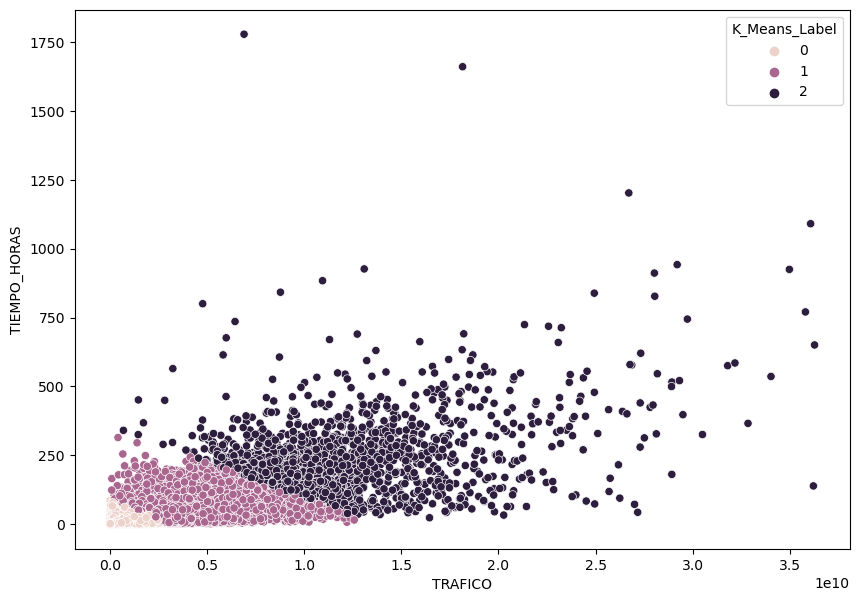

In [184]:
#Not as useful as expected, could be useful if we use color for age and shape for label.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_n_cluster, x='TRAFICO', y='TIEMPO_HORAS', hue = 'K_Means_Label')
fig.show()

### Gráfico de dispersión - Tiempo en horas vs Trafico (Inclusión de Clusters y tipo de servicio)

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_20612\749590942.py:4: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



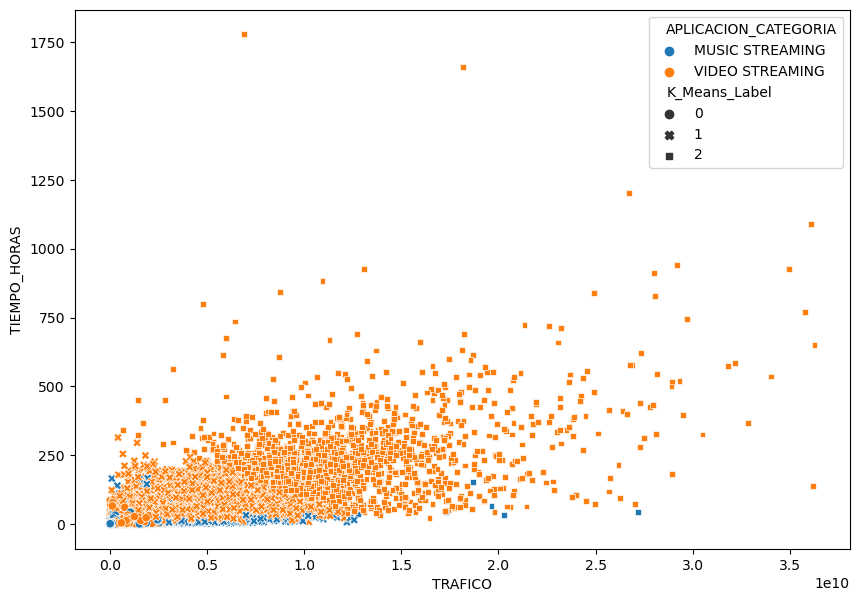

In [185]:
#Still confusing, not as useful as expected.
fig = plt.figure(figsize=(10,7))
sns.scatterplot(data=tigo_n_cluster, x='TRAFICO', y='TIEMPO_HORAS', hue = 'APLICACION_CATEGORIA', style='K_Means_Label')
fig.show()

## 5.1.4 Diagrama 3D de dispersión

### Diagrama 3D de dispersión - Tiempo en horas vs Trafico en GB vs Edad

In [190]:
labels_n = model.labels_

import plotly.express as px

fig=px.scatter_3d(data_frame=tigo_n_cluster,x='EDAD',y='TRAFICO_GB',z='TIEMPO_HORAS',color=labels_n, color_continuous_scale='bluered')
fig.update_layout(
    title={
        'text': 'Segmentación de clientes según la edad, Trafico de datos y tiempo de conexión',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

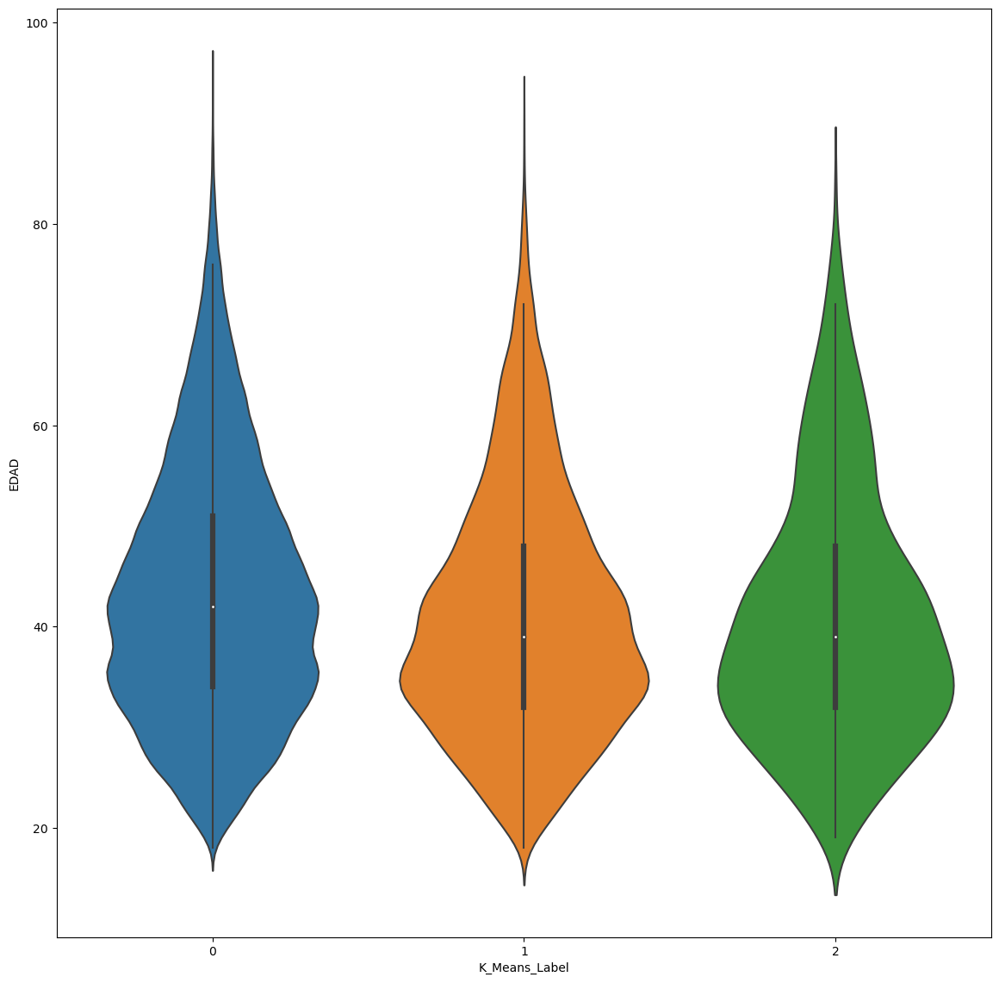

In [187]:
#Age Analysis
#Converting the diagram to percentage could help us show patterns more clearly.
plt.figure(figsize=(14, 14))
sns.violinplot(data=tigo_n_cluster, x="K_Means_Label", y="EDAD")
# Display the plot
plt.show()

In [188]:
#Grouped Data
pd.set_option('display.max_columns', None)  

tigo_dc_grouped = tigo_n_cluster.copy()
tigo_dc_grouped = tigo_dc_grouped.drop("USUARIO",axis=1)
tigo_dc_grouped = tigo_dc_grouped.drop("APLICACION",axis=1)
tigo_dc_grouped = tigo_dc_grouped.drop("APLICACION_CATEGORIA",axis=1)
tigo_dc_grouped = tigo_dc_grouped.drop("APLICACION_ID",axis=1)
tigo_dc_grouped = tigo_dc_grouped.drop("TRAFICO",axis=1)
tigo_dc_grouped.groupby("K_Means_Label").agg([np.mean, np.median, min, max])


EDAD                    TIEMPO_CONEXION                      
               mean median   min   max            mean    median      min   
K_Means_Label                                                               
0             43.15  42.00 18.00 95.00        13560.74   1311.00     1.00  \
1             40.97  39.00 18.00 91.00       237936.58 207860.00  6148.00   
2             40.79  39.00 19.00 84.00       862282.11 773620.50 84813.00   

                          TRAFICO_MB                                     
                     max        mean      median       min         max   
K_Means_Label                                                            
0              311941.00   174835.65     7458.33      1.21  2926629.49  \
1             1132681.00  3567090.69  3107956.88  87060.26 12277725.63   
2             6402138.00 11670037.20 10676889.09 673690.67 35422057.61   

              TRAFICO_GB                          TIEMPO_MIN                    
                    mean   median    min      max       mean   median     min   
K_Means_Label                                                                   
0                 170.74     7.28   0.00  2858.04     226.01    21.85    0.02  \
1                3483.49  3035.11  85.02 11989.97    3965.61  3464.33  102.47   
2               11396.52 10426.65 657.90 34591.85   14371.37 12893.67 1413.55   

                        TIEMPO_HORAS                       
                    max         mean median   min     max  
K_Means_Label                                              
0               5199.02         3.77   0.36  0.00   86.65  
1              18878.02        66.09  57.74  1.71  314.63  
2             106702.30       239.52 214.89 23.56 1778.37

In [189]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)